## Instructions

We would like to gauge the performance of TV advertising for company XYZ.

- Devise a method for calculating the website traffic that is attributable to TV advertising.
- Devise an appropriate metric for measuring TV ad performance.
- Using code, calculate your metrics for the above approaches.
- Present your findings, including working code.

2 datasets:
- Minute by Minute Web Traffic
- Individual TV Spots run

### Goal

Since this work is in the context of applying to a Data Scientist position, the primary to help present how I work and think about data problems. I decided to highlight the challenges and learnings that came out of the work. Remi.

### Initial Intuition & Plan

I assume that TV Spots would have 2 effects on Web traffic:
- immediate short-term boost (what I'm focusing on below)
- and a more diffuse long-term growth from brand awareness (I'm going to ignore it for now)

The plan for this study is to:
- Analyze the data sets to make sure I understand them
- Familiarize myself with Time Series using pandas
- Compute a Web Traffic baseline
- Compute Web Traffic lift over baseline
- Compute the Cost per Unique Visitor
- Associate lift to each TV Spot
- Extract some actionable insights for Buyers
- Highlight what I have learned as a Data Scientist


# Exploring the Web Traffic data set

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime

In [2]:
!head assignment-analyst-1-web-traffic-data.csv

time,traffic_source,value
2017-10-17 07:05:00+00,email,1
2017-10-17 07:07:00+00,email,1
2017-10-17 07:16:00+00,email,1
2017-10-17 07:17:00+00,email,1
2017-10-17 07:25:00+00,email,1
2017-10-17 07:34:00+00,email,1
2017-10-17 07:38:00+00,email,1
2017-10-17 07:40:00+00,email,1
2017-10-17 07:42:00+00,email,1


In [3]:
df_web = pd.read_csv('assignment-analyst-1-web-traffic-data.csv', parse_dates=['time'], index_col='time').sort_index()

In [4]:
df_web.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 63951 entries, 2017-10-16 07:00:00 to 2017-11-13 07:59:00
Data columns (total 2 columns):
traffic_source    63951 non-null object
value             63951 non-null float64
dtypes: float64(1), object(1)
memory usage: 1.5+ MB


In [5]:
df_web.head(10)

,traffic_source,value
time,,
2017-10-16 07:00:00,direct,1.979961
2017-10-16 07:01:00,direct,0.865222
2017-10-16 07:02:00,direct,0.940746
2017-10-16 07:03:00,direct,1.377618
2017-10-16 07:04:00,direct,3.585375
2017-10-16 07:05:00,direct,0.701753
2017-10-16 07:06:00,direct,-0.225907
2017-10-16 07:07:00,direct,1.822373
2017-10-16 07:08:00,direct,1.856310


### column: time

In [6]:
(df_web.index.max() - df_web.index.min())

Timedelta('28 days 00:59:00')

In [7]:
(df_web.index.max() - df_web.index.min()).total_seconds()/60

40379.0

In [8]:
df_web.index.nunique()

40380

Observations:
- The data is sampled by minute
- We have values populated for every single minute in the 28 day & 1 hour time period

### column: traffic_source

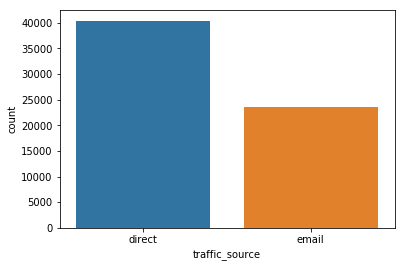

In [9]:
sns.countplot(df_web['traffic_source'])

### column: value

There are some negative values, which is strange, I'll assume these are caused by a bug and stand for 0

In [10]:
df_web[df_web['value'] < 0]

,traffic_source,value
time,,
2017-10-16 07:06:00,direct,-0.225907
2017-10-17 07:07:00,direct,-0.159863
2017-10-18 07:06:00,direct,-0.216864
2017-10-28 07:03:00,direct,-0.584159
2017-10-30 07:06:00,direct,-0.469876
2017-11-02 07:05:00,direct,-0.447271
2017-11-03 07:08:00,direct,-0.158059


In [11]:
df_web['value'] = np.maximum(0, df_web['value'])

Let's rename 'value' to 'visitors' for clarity

In [12]:
df_web.columns = ['traffic_source', 'visitors']

## Email Traffic

Text(0.5,1,'Email Traffic 5 min granularity')

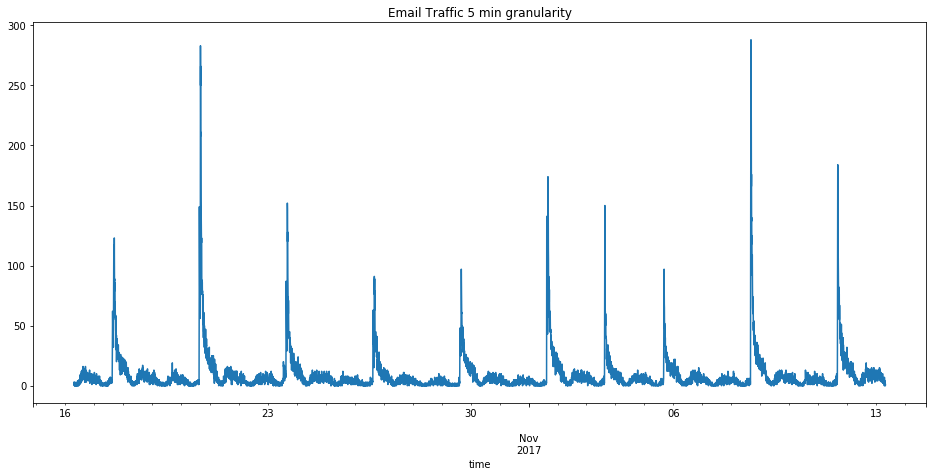

In [13]:
web_email = df_web[df_web['traffic_source'] == 'email']
email_5min = web_email.resample('5T')['visitors'].sum()
email_5min.plot(figsize=(16,7))
plt.title('Email Traffic 5 min granularity')

We have a few spikes, every few days, all around 4pm, I'm guessing this is tied to an marketing email/newsletter. <br>
Let's ignore Email Traffic for now.

## Direct Traffic

Text(0.5,1,'Direct Traffic 5 min granularity')

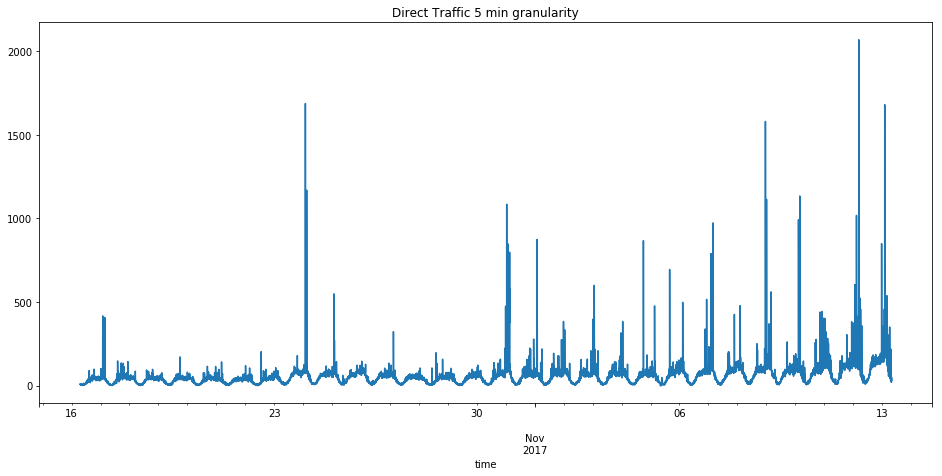

In [14]:
web_direct = df_web[df_web['traffic_source'] == 'direct']
web_direct.resample('5T')['visitors'].sum().plot(figsize=(16,7))
plt.title('Direct Traffic 5 min granularity')

We're seeing a lot of spikes in traffic, I suspect these are the effect of TV Spots or other marketing efforts that have a focused effect.

Text(0.5,1,'Direct Traffic 1H granularity')

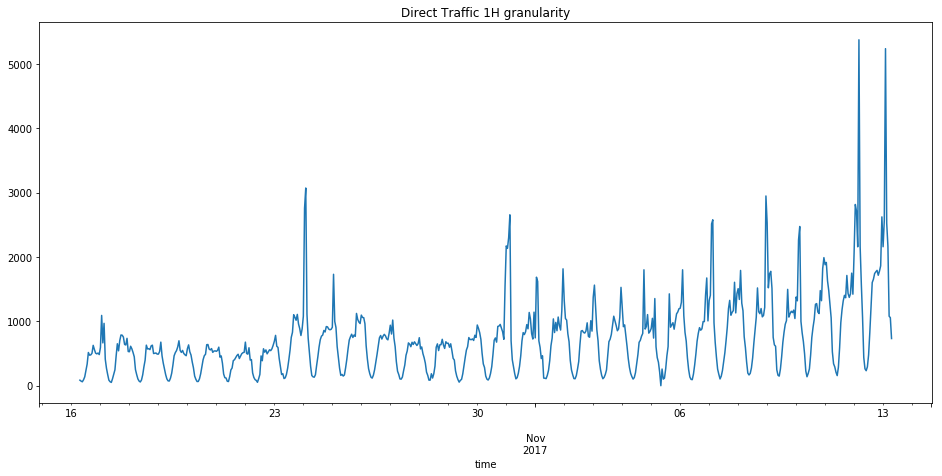

In [15]:
web_direct.resample('1H')['visitors'].sum().plot(figsize=(16,7))
plt.title('Direct Traffic 1H granularity')

The hourly view shows strong daily seasonality, with an increasing number of spikes.

Text(0.5,1,'Direct Traffic 1 Day granularity')

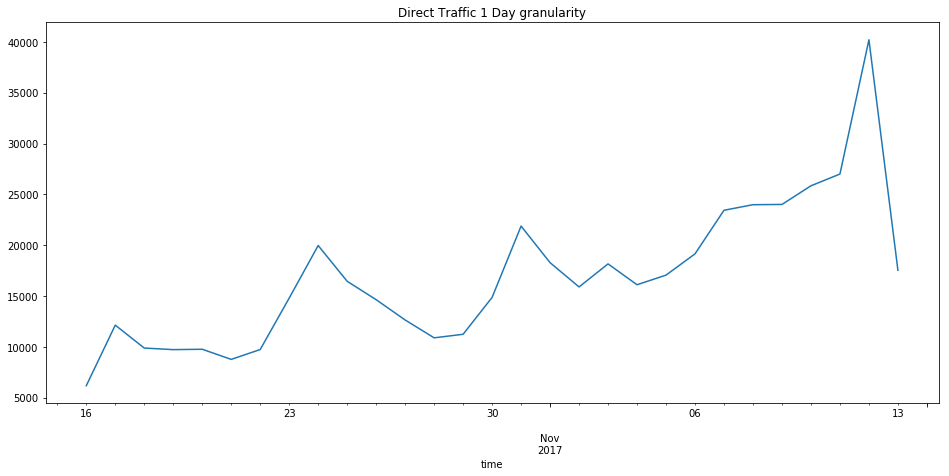

In [16]:
web_direct.resample('1D')['visitors'].sum().plot(figsize=(16,7))
plt.title('Direct Traffic 1 Day granularity')

Overall we are seeing growth in Direct traffic over time

# Exploring the TV Spot data set

In [17]:
df_spot = pd.read_csv('assignment-analyst-1-spot-data.csv', parse_dates=['time'])

In [18]:
df_spot.head()

,id,time,creative_id,spend,program,duration,network_code,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed
0,411630,2017-10-16 12:25:32,f3483f810d44cef79d90a66ab2da1bf0,69.7,RAISING HOPE,14.0,FXX,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0
1,411630,2017-10-16 15:25:32,f3483f810d44cef79d90a66ab2da1bf0,15.3,RAISING HOPE,14.0,FXX,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,2.0
2,411631,2017-10-16 12:56:36,eff6a8d032a8ca3ae098381569a9c15f,69.7,RAISING HOPE,14.0,FXX,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0
3,411631,2017-10-16 15:56:36,eff6a8d032a8ca3ae098381569a9c15f,15.3,RAISING HOPE,14.0,FXX,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,2.0
4,411651,2017-10-16 14:38:41,5992d996de2f11faa3492960a58de350,69.7,PARKS AND RECREATION,14.0,FXX,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0


The most interesting field here is <b>spend</b> since it will help us compute the Cost to acquire a User.

Other actionable fields are:
- program (the name of the program during which the spot was run)
- network_code (the network it ran on)
- duration of the spot


#### Resampling to 1 minute
Each row is a TV Spot run, with the exact second it ran. Let's resample the data to the closest minute so we can easily join with the Web Traffic data set.

In [19]:
# Set DateTimeIndex
df_spot.set_index('time', inplace=True)

# Resample to 1 minute
df_spot.index = df_spot.index.floor('T')

df_spot.sort_index(inplace=True)

Let's look at uniqueness

In [20]:
print("Data points:", len(df_spot))
print("Unique Values:")
print(df_spot.nunique())

Data points: 1456
Unique Values:
id                728
creative_id         8
spend              80
program           128
duration            8
network_code       21
is_dual_feed        1
rotation           18
rotation_days       5
rotation_start     16
rotation_end       10
feed                2
dtype: int64


We don't have unique IDs to represent a spot running at 1 point in time. It will be useful later.

In [21]:
# Generate Unique IDs
df_spot['uid'] = np.arange(1, len(df_spot)+1)

Let's also rearrange column order so it's easier to work work

In [22]:
df_spot = df_spot[['uid', 'spend', 'network_code', 'program', 'duration', 
                   'is_dual_feed', 'rotation', 'rotation_days', 'rotation_start',
                   'rotation_end', 'feed', 'id', 'creative_id' ]]

In [23]:
df_spot.head()

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id
time,,,,,,,,,,,,,
2017-10-16 12:25:00,1,69.70,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411630,f3483f810d44cef79d90a66ab2da1bf0
2017-10-16 12:56:00,2,69.70,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411631,eff6a8d032a8ca3ae098381569a9c15f
2017-10-16 14:38:00,3,69.70,FXX,PARKS AND RECREATION,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411651,5992d996de2f11faa3492960a58de350
2017-10-16 14:38:00,4,111.52,VEL,FANTOMWORKS,17.0,True,Weekday Day,"{1,2,3,4,5}",09:00:00,16:00:00,1.0,411652,f3483f810d44cef79d90a66ab2da1bf0
2017-10-16 15:25:00,5,15.30,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,2.0,411630,f3483f810d44cef79d90a66ab2da1bf0


## Visualize Traffic & TV spots together
It will be very helpful to display both data sets together in order to get a visual sense of how they interact.<br>
We use plotly so we can interact with the timeline.

In [24]:
# from plotly import __version__
# import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot #download_plotlyjs, plot
import cufflinks as cf

# For Notebooks & Offline
init_notebook_mode(connected=True)
cf.go_offline()

In [25]:
def plot_data(time_slice=slice(None)):
    """
    Plots interactive timeseries chart of Web Direct traffic next to Ad Spot data.
    Data is plotted at 1-minute granularity to allow zooming into the chart.
    """
    
    # Selects a specific slice of time to display.
    # Both data set share a DateTimeIndex with 1 second granularity
    web_slice = web_direct[time_slice]
    spot_slice = df_spot[time_slice]


    # Display visitors as a blue line chart
    
    visitors_chart = go.Scatter(
        x = web_slice.index,
        y = web_slice['visitors'],
        mode='lines',
        name='Web Direct Visitors',
        line=dict(
            shape='hvh',
            color='darkblue',
            width=0.5,        
        )
    )

    
    # Display Spend as an orange Bar chart on its own Y-axis
    # with X-axis (time) shared
    
    spend_chart = go.Bar(
        x = spot_slice.index,
        y = spot_slice['spend'],
        name = 'Ad Spend $',
        marker = dict(color='orange'),
        yaxis='y2'
    )

    
    # Build title
    from_time = np.minimum(web_slice.index[0], spot_slice.index[0])
    to_time = np.maximum(web_slice.index[-1], spot_slice.index[-1])
    title = 'Web Traffic & TV Ad Spend between {} and {}'.format(from_time, to_time)


    layout = go.Layout(legend=dict(x=0.75, y=0.96),
                       height=700,
                       title = title,
                       yaxis=dict(
                           title='Web visitors (Direct)',
                           domain=[0.22, 1]), # Top 78% is reserved for the 1st axis
                       yaxis2=dict(
                           title='Ad Spend $',
                           domain=[0, 0.13], # Bottom 13% is reserved for the 2nd axis
        ))


    # Display
    data = [ visitors_chart, spend_chart ]
    iplot(go.Figure(data=data, layout=layout))
    

# Visualize the whole data set
plot_data()

This is great! We can see first-hand the relationship between Ad spot and lift:
- When lift occurs, it spikes with 1 minute, then ends within a few minutes

In [26]:
# Visualize a 1-hour period with a TV Spot and Lift
plot_data(slice('2017-11-07 21:00', '2017-11-07 22:00'))

## Determining Baseline for Web Traffic

We are only going to look at Web Direct Traffic from now on since Email traffic would be unaffected by TV Spots.

We improve a new function to display the data alongside a Baseline.

In [27]:
def plot_data_v2(time_slice=slice(None), baseline=None):
    """
    Plots interactive timeseries chart of Web Direct traffic next to Ad Spot data.
    Data is plotted at 1-minute granularity ands allow zooming into the chart.
    
    Args:
    - time_slice: The slice of time to chart
    - baseline: A pandas Series aiming to determine Traffic without TV Spots
    """
    
    # Selects a specific slice of time to display.
    # Both data set share a DateTimeIndex with 1 second granularity
    web_slice = web_direct[time_slice]
    spot_slice = df_spot[time_slice]

    
    data = []

    # Display visitors as a blue line chart    
    data.append(go.Scatter(
        x = web_slice.index,
        y = web_slice['visitors'],
        mode='lines',
        name='Web Direct Visitors',
        line=dict(
            shape='hvh',
            color='darkblue',
            width=0.5,        
        )
    ))


    # NEW: display baseline as green line
    if baseline is not None:
        baseline_slice = baseline[time_slice]

        data.append(go.Scatter(
            x = baseline_slice.index,
            y = baseline_slice.values,
            mode='lines',
            name='Web Direct Visitors Baseline',
            line=dict(
                shape='hvh',
                color='green',
                width=3,
            )
        ))
        

    # Display Spend as an orange Bar chart on its own Y-axis
    # with X-axis (time) shared
    
    data.append(go.Bar(
        x = spot_slice.index,
        y = spot_slice['spend'],
        name = 'Ad Spend $',
        marker = dict(color='orange'),
        yaxis='y2'
    ))



    # Build title
    from_time = np.minimum(web_slice.index[0], spot_slice.index[0])
    to_time = np.maximum(web_slice.index[-1], spot_slice.index[-1])
    title = 'Web Direct Visitors & TV Ad Spend between {} and {}'.format(from_time, to_time)

    
    # Put it all together
    layout = go.Layout(legend=dict(x=0.75, y=0.96),
                       height=700,
                       title = title,
                       yaxis=dict(
                           title='Web Direct Visitors',
                           domain=[0.22, 1]), # Top 78% is reserved for the 1st axis
                       yaxis2=dict(
                           title='Ad Spend $',
                           domain=[0, 0.14], # Bottom 14% is reserved for the 2nd axis
        ))


    # Display
    iplot(go.Figure(data=data, layout=layout))

### 10-min Rolling Average as a Baseline

In [28]:
baseline = web_direct['visitors'].rolling(10).mean()

# Visualize a 12-hour period with 
plot_data_v2(slice('2017-11-06 19:00', '2017-11-07 07:00'), baseline=baseline)

### 10-min Rolling Median as Baseline

In [29]:
baseline = web_direct['visitors'].rolling(10).median()
plot_data_v2(slice('2017-11-06 19:00', '2017-11-07 07:00'), baseline=baseline)

### 30-min Rolling Median as Baseline

In [30]:
baseline = web_direct['visitors'].rolling(30).median()
plot_data_v2(slice('2017-11-06 19:00', '2017-11-07 07:00'), baseline=baseline)

## Another approach: observing difference between contiguous data points

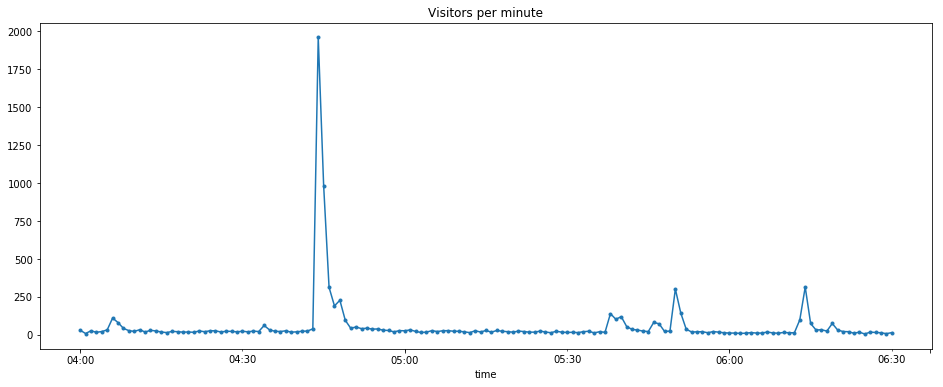

In [31]:
web_slice = web_direct['2017-11-12 04:00':'2017-11-12 06:30']
web_slice['visitors'].plot(figsize=(16,6), marker='.', title='Visitors per minute')

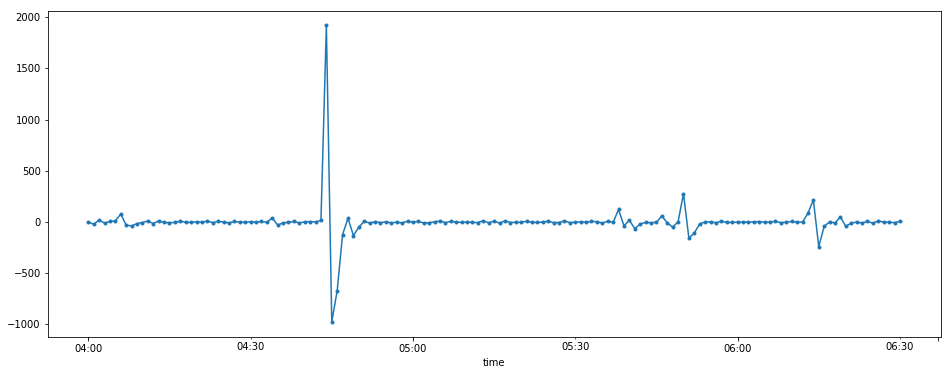

In [32]:
web_slice['visitors'].diff().fillna(0).plot(figsize=(16,6), marker='.')

## Observing pct_change

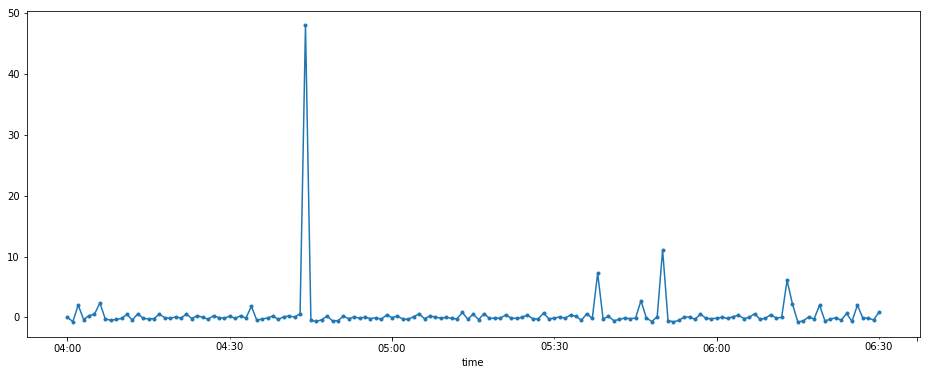

In [33]:
web_slice['visitors'].pct_change().fillna(0).plot(figsize=(16,6), marker='.')

pct_change() is a strong signal at the beginning of lift, but not as useful to pinpoint the end.

# Computing Lift

### V3 of our plotting function which add visualization for Lift

In [34]:
def plot_data_v3(time_slice=slice(None), baseline=None, lift_mask=None):
    """
    Plots interactive timeseries chart of Web Direct traffic next to Ad Spot data.
    Data is plotted at 1-minute granularity ands allow zooming into the chart.
    
    Args:
    - time_slice: The slice of time to chart
    - baseline: A pandas Series aiming to determine Traffic without TV Spots
    - lift: A pandas Series of booleans indicating which data points are part of a lift
"""

    # If no lift mask is passed, default it to zeros.
    if lift_mask is None:
        lift_mask = pd.Series(np.zeros(len(web_direct.index)), index=web_direct.index)


    # Selects a specific slice of time to display.
    # Both data set share a DateTimeIndex with 1 second granularity
    web_slice = web_direct[time_slice]
    spot_slice = df_spot[time_slice]
    lift_mask_slice = lift_mask[time_slice]

        
    charts = []

    # Display visitors as a blue line chart 
    # We also display markers: blue for regular data points, Red for those determined to be Lift
    charts.append(go.Scatter(
        x = web_slice.index,
        y = web_slice['visitors'],
        mode='markers+lines',
        name='Web Direct Visitors (Lift: Red)',
        line=dict(
            shape='hvh',
            color='darkblue',
            width=0.5,        
        ),
        marker=dict(
            size=5,
            color=(lift_mask_slice*1),
            colorscale=[[0.0, 'darkblue'], [1, 'red']])
    ))


    if baseline is not None:
        baseline_slice = baseline[time_slice]

        charts.append(go.Scatter(
            x = baseline_slice.index,
            y = baseline_slice.values,
            mode='lines',
            name='Web Direct Visitors Baseline',
            line=dict(
                shape='hvh',
                color='green',
                width=3,
            )
        ))
        

    # Display Spend as an orange Bar chart on its own Y-axis
    # with X-axis (time) shared
    
    labels = '[' + spot_slice['network_code'] + '] ' + spot_slice['program'] + '<br>UID:' + spot_slice['uid'].astype(str)

    charts.append(go.Bar(
        x = spot_slice.index,
        y = spot_slice['spend'],
        name = 'Ad Spend $',
        marker = dict(color='orange'),
        text = labels,
        yaxis='y2'
    ))



    # Build title
    from_time = np.minimum(web_slice.index[0], spot_slice.index[0])
    to_time = np.maximum(web_slice.index[-1], spot_slice.index[-1])
    title = 'Web Direct Visitors & TV Ad Spend between {} and {}'.format(from_time, to_time)

    
    # Put it all together
    layout = go.Layout(legend=dict(x=0.75, y=0.96),
                       height=700,
                       title = title,
                       yaxis=dict(
                           title='Web Direct Visitors',
                           domain=[0.22, 1]), # Top 78% is reserved for the 1st axis
                       yaxis2=dict(
                           title='Ad Spend $',
                           domain=[0, 0.14], # Bottom 14% is reserved for the 2nd axis
        ))


    # Display
    iplot(go.Figure(data=charts, layout=layout))

### Lift as "20 visitors above baseline"

In [35]:
baseline = web_direct['visitors'].rolling(30, min_periods=1).median()
lift_mask = (web_direct['visitors'] > baseline + 20)

plot_data_v3(slice('2017-11-04 00:00', '2017-11-05 12:00'),
             baseline=baseline,
             lift_mask=lift_mask)

### Lift as 50% above Baseline

In [36]:
baseline = web_direct['visitors'].rolling(30, min_periods=1).median()
lift_mask = (web_direct['visitors'] >= baseline * 1.50)

plot_data_v3(slice('2017-11-04', '2017-11-14'),
            baseline=baseline,
            lift_mask=lift_mask)

### Lift as 50% above Baseline, with at least a lift of 10 above baseline

In [37]:
baseline = web_direct['visitors'].rolling(30, min_periods=1).median()
lift_mask = (web_direct['visitors'] >= np.maximum(baseline * 1.50, baseline + 10))

plot_data_v3(slice('2017-11-04 19:00', '2017-11-05 07:00'),
             baseline=baseline,
             lift_mask=lift_mask)

## Observing Rolling Standard Deviation

In [38]:
rolling_std = web_direct.rolling(10)['visitors'].std().fillna(0)
rolling_std.name = 'rolling_std'
web_direct.join(rolling_std)[[ 'visitors', 'rolling_std' ]].iplot()

# Aggregate Lift ROI

In [39]:
web_direct['baseline'] = web_direct['visitors'].rolling(30, min_periods=1).median()

/Users/rgabillet/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [40]:
lift_mask = (web_direct['visitors'] >= np.maximum(web_direct['baseline'] * 1.50, web_direct['baseline'] + 10))

web_direct['visitors_lift'] = np.abs(web_direct['visitors'] - web_direct['baseline']) * 1.0 * lift_mask

/Users/rgabillet/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [41]:
web_direct.head()

,traffic_source,visitors,baseline,visitors_lift
time,,,,
2017-10-16 07:00:00,direct,1.979961,1.979961,0.0
2017-10-16 07:01:00,direct,0.865222,1.422591,0.0
2017-10-16 07:02:00,direct,0.940746,0.940746,0.0
2017-10-16 07:03:00,direct,1.377618,1.159182,0.0
2017-10-16 07:04:00,direct,3.585375,1.377618,0.0


### Look at Lift & Spend on Daily basis

In [42]:
# Daily Lift
df_daily = web_direct.resample('1D')[ 'baseline', 'visitors_lift' ].sum()
df_daily.iplot(kind='bar', barmode='stack', colors=['green', 'red'])

In [43]:
# Daily spend
df_spend_daily = df_spot.resample('1D')['spend'].sum()

In [44]:
df_spend_daily.iplot(kind='bar')

In [45]:
df_daily = df_daily.join(df_spend_daily)
df_daily.head()

,baseline,visitors_lift,spend
time,,,
2017-10-16,5729.708624,238.0,975.80
2017-10-17,10204.337338,1890.5,6567.78
2017-10-18,9155.243653,450.0,2375.24
2017-10-19,9232.659346,269.5,2006.68
2017-10-20,9194.205239,413.5,2987.92


In [46]:
df_daily['cost_per_user'] = df_daily['spend'] / df_daily['visitors_lift']

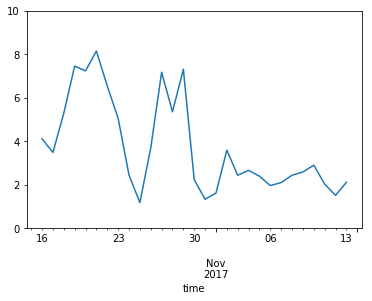

In [47]:
figure = df_daily['cost_per_user'].plot(ylim=(0,10))

# Associate Lifts to Spots

### Resample Lift index

In [48]:
spots_per_minute = df_spot.resample('T')['id'].count()
spots_per_minute.name = 'spots_per_minute'

In [49]:
spots_per_minute[spots_per_minute > 1].head()

time
2017-10-16 14:38:00    2
2017-10-16 17:38:00    2
2017-10-17 22:39:00    2
2017-10-18 01:39:00    2
2017-10-18 14:28:00    2
Name: spots_per_minute, dtype: int64

In some instances more than 1 spot started within the same minute.

In [50]:
df_spot.loc['2017-10-16 14:38:00']

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id
time,,,,,,,,,,,,,
2017-10-16 14:38:00,3,69.70,FXX,PARKS AND RECREATION,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411651,5992d996de2f11faa3492960a58de350
2017-10-16 14:38:00,4,111.52,VEL,FANTOMWORKS,17.0,True,Weekday Day,"{1,2,3,4,5}",09:00:00,16:00:00,1.0,411652,f3483f810d44cef79d90a66ab2da1bf0


### Associate spot to Lift from same minute until end of lift

In [51]:
df_spot['2017-11-05 03:00':'2017-11-05 04:00']

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id
time,,,,,,,,,,,,,
2017-11-05 03:22:00,963,1045.50,HIST,AMERICAN PICKERS,14.0,True,Everyday Prime (mirrored),"{1,2,3,4,5,6,7}",20:00:00,00:00:00,1.0,434705,f3483f810d44cef79d90a66ab2da1bf0
2017-11-05 03:27:00,964,30.60,NBAT,NBA GAMETIME,13.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,432256,6570d4e06efb97840eec4d9d46cde0bb
2017-11-05 03:37:00,965,250.92,VICE,MOVIE,14.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,1.0,434706,efc5636dd257db2a6cf7cff2569f7d59


In [52]:
plot_data_v3(slice('2017-11-05 03:00', '2017-11-05 04:00'), lift_mask=lift_mask)

## Merge Web and Spot data

Whichever is the last spot that ran is considered the "latest running spot".<br>

In [53]:
df_web_spots = web_direct.join(df_spot['uid'])
df_web_spots

,traffic_source,visitors,baseline,visitors_lift,uid
time,,,,,
2017-10-16 07:00:00,direct,1.979961,1.979961,0.0,NaN
2017-10-16 07:01:00,direct,0.865222,1.422591,0.0,NaN
2017-10-16 07:02:00,direct,0.940746,0.940746,0.0,NaN
2017-10-16 07:03:00,direct,1.377618,1.159182,0.0,NaN
2017-10-16 07:04:00,direct,3.585375,1.377618,0.0,NaN
2017-10-16 07:05:00,direct,0.701753,1.159182,0.0,NaN
2017-10-16 07:06:00,direct,0.000000,0.940746,0.0,NaN
2017-10-16 07:07:00,direct,1.822373,1.159182,0.0,NaN
2017-10-16 07:08:00,direct,1.856310,1.377618,0.0,NaN


In [54]:
df_web_spots.columns = ['traffic_source', 'visitors', 'baseline', 'visitors_lift', 'spot_uid']
df_web_spots['spot_uid'].fillna(method='ffill', inplace=True)

In [55]:
df_web_spots.loc['2017-11-05 03:00':'2017-11-05 04:00']

,traffic_source,visitors,baseline,visitors_lift,spot_uid
time,,,,,
2017-11-05 03:00:00,direct,19.0,12.0,0.0,962.0
2017-11-05 03:01:00,direct,10.0,11.5,0.0,962.0
2017-11-05 03:02:00,direct,9.0,11.5,0.0,962.0
2017-11-05 03:03:00,direct,12.0,12.0,0.0,962.0
2017-11-05 03:04:00,direct,13.0,12.0,0.0,962.0
2017-11-05 03:05:00,direct,14.0,12.0,0.0,962.0
2017-11-05 03:06:00,direct,11.0,12.0,0.0,962.0
2017-11-05 03:07:00,direct,14.0,12.0,0.0,962.0
2017-11-05 03:08:00,direct,11.0,12.0,0.0,962.0


In [56]:
# TODO: spots per minute adjustment

def agg_spot_uid(df_group):
    # executed for each spot_uid group of the DF
    d = {}
    d['visitors_lift'] = (df_group['visitors_lift']).sum() # / df_group['spots_per_minute']).sum()
    d['lift_duration_minutes'] = (df_group['visitors_lift'] > 0).sum()
    return pd.Series(d, index=d.keys())


df_by_spot_uid = df_web_spots.groupby('spot_uid').apply(agg_spot_uid).sort_values('lift_duration_minutes', ascending=False)
df_by_spot_uid.head()

,visitors_lift,lift_duration_minutes
spot_uid,,
662.0,1489.5,9.0
289.0,1664.0,8.0
653.0,1076.0,8.0
730.0,1590.5,8.0
1361.0,520.0,7.0


In [57]:
df_spot[df_spot['uid'] == 662]

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id
time,,,,,,,,,,,,,
2017-10-31 02:50:00,662,55.08,VEL,OVERHAULIN',14.0,True,Weekday Early Fringe,"{1,2,3,4,5}",16:00:00,20:00:00,2.0,423266,efc5636dd257db2a6cf7cff2569f7d59


In [58]:
def plot_data_around_spot_uid(spot_uid):
    at = df_spot[df_spot['uid'] == spot_uid].index[0]

    baseline = web_direct['visitors'].rolling(30, min_periods=1).median()
    lift_mask = (web_direct['visitors'] >= np.maximum(baseline * 1.50, baseline + 10))

    plot_data_v3(slice(at - datetime.timedelta(hours=1), at + datetime.timedelta(hours=1)),
                 baseline=baseline,
                 lift_mask=lift_mask)
    
plot_data_around_spot_uid(662)

There is a problem: Spot 662 is associated to a lift taking place 14 minutes after the spot came on.

### Adjust the ffill

At the end of a lift, we need to stop assigning it to a Spot

In [59]:
def unassign_spots_after_lift_ends(df):
    """
    Iterates through rows of the Web + Spot Data in order to unassign spots from lifts given that:
    - a spot can only start a lift in the same minute or 1 minute later
    - once the lift is complete, the spot cannot trigger another lift
    """

    adjusted_spot_uid = []
    lift_is_ongoing = False
    
    last_lift_spot_uid = None
    previous_spot_uid = None
    minutes_since_spot = None

    for at, row in df.iterrows():            
        if row['spot_uid'] and row['spot_uid'] != previous_spot_uid:
            previous_spot_uid = row['spot_uid']
            minutes_since_spot = 0
        else:
            minutes_since_spot = minutes_since_spot + 1
        
        if row['visitors_lift'] > 0:
            lift_is_ongoing = True

        elif lift_is_ongoing and row['visitors_lift'] == 0:
            # lift ended
            lift_is_ongoing = False
            last_lift_spot_uid = row['spot_uid']
        
        elif not lift_is_ongoing:
            if minutes_since_spot >= 1: # no lift after 2 minutes, this spot won't get any lift
                last_lift_spot_uid = row['spot_uid']
        


        # Once a lift ends for a given spot, we exclude this spot from being assigned another lift
        if lift_is_ongoing and (last_lift_spot_uid != row['spot_uid']):
            adjusted_spot_uid.append(row['spot_uid']) 
        else:
            adjusted_spot_uid.append(np.nan)

         
    return pd.Series(data=adjusted_spot_uid, index=df.index)


df_web_spots['adjusted_spot_uid'] = unassign_spots_after_lift_ends(df_web_spots)

In [60]:
df_web_spots[df_web_spots['spot_uid'] == 662]

,traffic_source,visitors,baseline,visitors_lift,spot_uid,adjusted_spot_uid
time,,,,,,
2017-10-31 02:50:00,direct,22.0,24.0,0.0,662.0,NaN
2017-10-31 02:51:00,direct,11.0,23.5,0.0,662.0,NaN
2017-10-31 02:52:00,direct,18.0,22.5,0.0,662.0,NaN
2017-10-31 02:53:00,direct,21.0,22.0,0.0,662.0,NaN
2017-10-31 02:54:00,direct,10.0,22.0,0.0,662.0,NaN
2017-10-31 02:55:00,direct,22.0,22.0,0.0,662.0,NaN
2017-10-31 02:56:00,direct,17.0,22.0,0.0,662.0,NaN
2017-10-31 02:57:00,direct,22.0,22.0,0.0,662.0,NaN
2017-10-31 02:58:00,direct,16.0,21.5,0.0,662.0,NaN


Looks good, let's overwrite spot_uid.

In [61]:
df_web_spots.drop('spot_uid', axis=1, inplace=True)
df_web_spots.columns = ['traffic_source', 'visitors', 'baseline', 'visitors_lift', 'spot_uid']

Let's look at the aggregate Spot data again

In [62]:
df_by_spot_uid = df_web_spots.groupby('spot_uid').apply(agg_spot_uid).sort_values('lift_duration_minutes', ascending=False)
df_by_spot_uid.head()

,visitors_lift,lift_duration_minutes
spot_uid,,
289.0,1664.0,8.0
730.0,1590.5,8.0
653.0,1076.0,8.0
1361.0,520.0,7.0
1418.0,2119.5,6.0


In [63]:
plot_data_around_spot_uid(289)

### Merge Lift data into Spot data

In [64]:
df_spot_lift = df_spot.reset_index().merge(df_by_spot_uid.reset_index(), how='outer', left_on='uid', right_on='spot_uid')
df_spot_lift = df_spot_lift.set_index('time').sort_index()
df_spot_lift['visitors_lift'].fillna(0, inplace=True)
df_spot_lift.head()

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id,spot_uid,visitors_lift,lift_duration_minutes
time,,,,,,,,,,,,,,,,
2017-10-16 12:25:00,1,69.70,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411630,f3483f810d44cef79d90a66ab2da1bf0,NaN,0.0,NaN
2017-10-16 12:56:00,2,69.70,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411631,eff6a8d032a8ca3ae098381569a9c15f,NaN,0.0,NaN
2017-10-16 14:38:00,3,69.70,FXX,PARKS AND RECREATION,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,1.0,411651,5992d996de2f11faa3492960a58de350,NaN,0.0,NaN
2017-10-16 14:38:00,4,111.52,VEL,FANTOMWORKS,17.0,True,Weekday Day,"{1,2,3,4,5}",09:00:00,16:00:00,1.0,411652,f3483f810d44cef79d90a66ab2da1bf0,4.0,97.0,2.0
2017-10-16 15:25:00,5,15.30,FXX,RAISING HOPE,14.0,True,Weekday Day,"{1,2,3,4,5}",07:00:00,15:00:00,2.0,411630,f3483f810d44cef79d90a66ab2da1bf0,NaN,0.0,NaN


## Which program has the best ROI / Cost per Unique Visitor ?

In [65]:
def agg_cost_per_unique_visitor(df_group):
    # executed for each "program" slice of the DF
    d = {}
    d['spend'] = df_group['spend'].sum()
    d['visitors_lift'] = df_group['visitors_lift'].sum()
    d['cuv'] = (d['spend'] / d['visitors_lift'])
    return pd.Series(d, index=d.keys())

/Users/rgabillet/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning:

divide by zero encountered in double_scalars



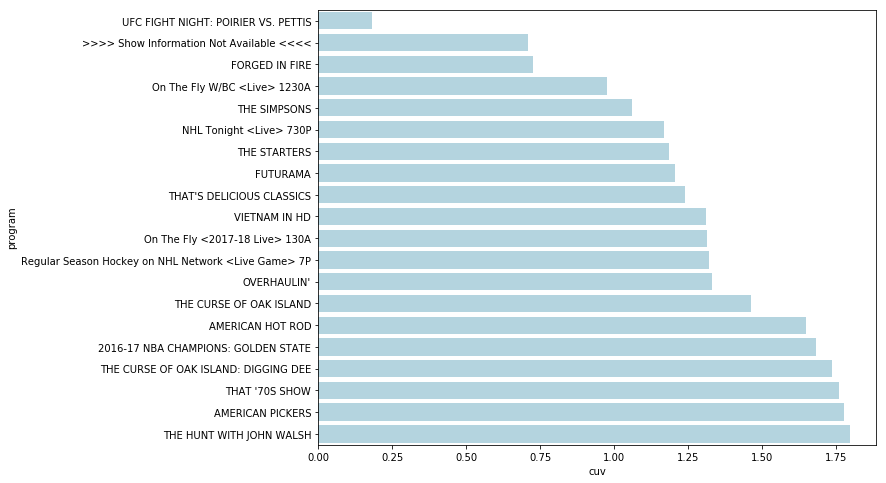

In [66]:
df_spot_by_program = df_spot_lift.groupby('program').apply(agg_cost_per_unique_visitor).sort_values('cuv').reset_index()
df_spot_by_program.head(15)

plt.figure(figsize=(10,8))
sns.barplot(y='program', x='cuv', data=df_spot_by_program.head(20), color='lightblue')

In [67]:
df_spot_lift[df_spot_lift['program'] == 'UFC FIGHT NIGHT: POIRIER VS. PETTIS']

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id,spot_uid,visitors_lift,lift_duration_minutes
time,,,,,,,,,,,,,,,,
2017-11-12 04:43:00,1360,473.96,FS1,UFC FIGHT NIGHT: POIRIER VS. PETTIS,29.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,1.0,449040,6e69270e444e10a1ec9a2bdfbb739c05,1360.0,3201.5,4.0
2017-11-12 07:43:00,1371,104.04,FS1,UFC FIGHT NIGHT: POIRIER VS. PETTIS,29.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,449040,6e69270e444e10a1ec9a2bdfbb739c05,NaN,0.0,NaN


In [68]:
plot_data_around_spot_uid(1360)

## How about the worst programs?

5.4k spend with no lift whatsoever

In [69]:
df_spot_by_program[df_spot_by_program['visitors_lift'] == 0]

,program,spend,visitors_lift,cuv
106,THREE'S COMPANY,297.50,0.0,inf
107,UFC RELOADED,578.00,0.0,inf
108,NHL Network Countdown 6P,127.50,0.0,inf
109,THE ULTIMATE FIGHTER: A NEW WORLD CH,289.00,0.0,inf
110,On The Fly <2017-18 Live> 1130P,127.50,0.0,inf
111,EVERYBODY HATES CHRIS,127.50,0.0,inf
112,On The Fly <2017-18 Live> 11P,382.50,0.0,inf
113,On The Fly <2017-18 Live> 12A,382.50,0.0,inf
114,On The Fly <2017-18 Tape> 10A,318.75,0.0,inf
115,On The Fly <2017-18 Tape> 6A,531.25,0.0,inf


In [70]:
_ = df_spot_by_program[df_spot_by_program['visitors_lift'] == 0]['spend'].sum()
print("Spend on pograms that brought in no lift: ", _)

_ = df_spot['spend'].sum()
print("Total Spend: ", _)

Spend on pograms that brought in no lift:  5403.45
Total Spend:  165551.1


## Which network has the best ROI?

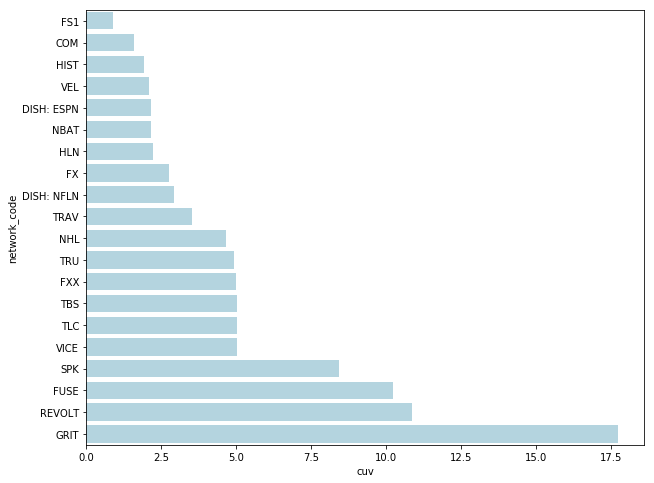

In [71]:
df_spot_by_network = df_spot_lift.groupby('network_code').apply(agg_cost_per_unique_visitor).sort_values('cuv').reset_index()
df_spot_by_network.head(15)

plt.figure(figsize=(10,8))
sns.barplot(y='network_code', x='cuv', data=df_spot_by_network.head(20), color='lightblue')

### ROI by day of week

In [72]:
df_spot_lift['dayofweek'] = df_spot.index.dayofweek

In [73]:
df_by_dayofweek = df_spot_lift.groupby('dayofweek')[['spend', 'visitors_lift']].sum()
df_by_dayofweek['cuv'] = df_by_dayofweek['spend'] / df_by_dayofweek['visitors_lift']
df_by_dayofweek.sort_values('cuv')

,spend,visitors_lift,cuv
dayofweek,,,
6,28309.505,11948.0,2.369393
0,21235.244,8941.5,2.374908
2,17570.860,7330.0,2.397116
1,32693.550,13588.5,2.405972
3,18150.509,4994.5,3.634099
4,30236.625,8209.0,3.683351
5,17354.807,4223.0,4.109592



# Next Steps

## Baseline

We chose a 30-minute rolling median as the Baseline. Some ideas to explore:

- Centered rolling median
- Look into Standard deviation
- Presence of a spot is a hint that their could be a lift
- Presence of a lift makes is more likely the lift will keep going
- Long-term impact / growth



## Lift detection

We chose 50% above baseline, with a minimum of 10 visitors as baseline. Some ideas to explore:
- better adjust for amount of traffic
- probability distribution of visitors

## ROI Analysis & Buyer Insights

- Offer more ways to slice the data
- Highlight Confidence intervals around CUV estimates since samples could be small
- Use regression to find most predictive features for ROI

In [77]:
df_spot_lift[df_spot['spend'] < 10]

,uid,spend,network_code,program,duration,is_dual_feed,rotation,rotation_days,rotation_start,rotation_end,feed,id,creative_id,spot_uid,visitors_lift,lift_duration_minutes,dayofweek
time,,,,,,,,,,,,,,,,,
2017-10-17 06:09:00,33,7.650,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,14.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,412676,f3483f810d44cef79d90a66ab2da1bf0,NaN,0.0,NaN,1
2017-10-17 06:19:00,34,7.650,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,14.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,412677,eff6a8d032a8ca3ae098381569a9c15f,NaN,0.0,NaN,1
2017-10-17 06:32:00,35,7.650,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,14.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,412678,5992d996de2f11faa3492960a58de350,NaN,0.0,NaN,1
2017-10-17 06:42:00,36,7.650,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,15.0,True,Everyday Prime,"{1,2,3,4,5,6,7}",19:00:00,00:00:00,2.0,412679,b6cc05016845138a72f2fa2e4f1f1a56,NaN,0.0,NaN,1
2017-10-17 23:09:00,94,6.120,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,14.0,True,Everyday Early Fringe,"{1,2,3,4,5,6,7}",16:00:00,19:00:00,2.0,413895,f3483f810d44cef79d90a66ab2da1bf0,NaN,0.0,NaN,1
2017-10-17 23:52:00,96,6.120,NBAT,2016-17 NBA CHAMPIONS: GOLDEN STATE,14.0,True,Everyday Early Fringe,"{1,2,3,4,5,6,7}",16:00:00,19:00:00,2.0,413896,eff6a8d032a8ca3ae098381569a9c15f,NaN,0.0,NaN,1
2017-10-18 00:13:00,97,6.120,NBAT,10 BEFORE TIP,14.0,True,Everyday Early Fringe,"{1,2,3,4,5,6,7}",16:00:00,19:00:00,2.0,413902,5992d996de2f11faa3492960a58de350,NaN,0.0,NaN,2
2017-10-18 01:13:00,98,6.120,NBAT,NBA GAMETIME,14.0,True,Everyday Early Fringe,"{1,2,3,4,5,6,7}",16:00:00,19:00:00,2.0,413920,b6cc05016845138a72f2fa2e4f1f1a56,NaN,0.0,NaN,2
2017-10-18 01:39:00,100,6.120,NBAT,NBA GAMETIME,13.0,True,Everyday Early Fringe,"{1,2,3,4,5,6,7}",16:00:00,19:00:00,2.0,413921,f3483f810d44cef79d90a66ab2da1bf0,NaN,0.0,NaN,2


In [79]:
plot_data_around_spot_uid(33, bbaseline, lift_mask)

TypeError: plot_data_around_spot_uid() takes 1 positional argument but 3 were given